In [32]:
!pip3 install torch torchvision torchaudio --quiet
!pip install gpytorch --quiet
!pip install mne --quiet
!pip install pandas --quiet
!pip install pywavelets --quiet

In [33]:
import os

DATASET_DIR = "/home/ec2-user/SageMaker/datasets/nsrr/shhs/polysomnography/"

# Get lists of all EDF and annotation files in their respective directories
edf_dir = os.path.join(DATASET_DIR, 'edfs/shhs1')
annot_dir = os.path.join(DATASET_DIR, 'annotations-events-nsrr/shhs1')

edf_files = sorted([os.path.join(edf_dir, f) for f in os.listdir(edf_dir) if f.endswith('.edf')])
annot_files = sorted([os.path.join(annot_dir, f) for f in os.listdir(annot_dir) if f.endswith('-nsrr.xml')])

# Zip the edf and annotation files together
file_paths = list(zip(edf_files, annot_files))

In [34]:
import mne
import numpy as np
import pandas as pd
import xml.etree.ElementTree as ET
from KC_algorithm.model import score_KCs
from KC_algorithm.plotting import KC_from_probas, plot_all_Kcs
import numpy as np
import matplotlib.pyplot as plt
from KC_algorithm.utils import EpochData
from mne.stats.parametric import _parametric_ci

################################################################
# Helper function to load the hypnogram from the NSRR .xml file

def import_event_and_stages_SHHS(xml_file):
    """
    Helper function to import stages and events of the Sleep Heart Health Study (SHHS)
    :param xml_file: xml file from NSRR SHHS files
    :return:
    - events: a dataframe with key 'onset', 'dur', 'label', covering each event, its onset, duration, and labels
    - stages: a dataframe with sleep stages
    """

    # Parse the XML string
    tree = ET.parse(xml_file)
    root = tree.getroot()
    
    # Initialize an empty list to store the stages
    stages = []
    events = []
    
    # Iterate over each ScoredEvent
    for event in root.findall("./ScoredEvents/ScoredEvent"):
        event_type = event.find('EventType').text
        event_concept = event.find('EventConcept').text
        start = float(event.find('Start').text)
        duration = float(event.find('Duration').text)
        
        # Check if the event concept indicates a sleep stage
        if event_type is not None and "Stages|Stages" in event_type:
            # Extract the sleep stage number from the event concept
            stage_number = event_concept.split('|')[1]
            stage = {
                'label': int(stage_number),
                'dur': duration,
                'onset': start
            }
            stages.append(stage)
            
        else:
            event = {
                'label': event_concept,
                'dur': duration,
                'onset': start
            }
            events.append(event)
    
    events = pd.DataFrame(events)
    stages = pd.DataFrame(stages)
    
    return events, stages

def get_avg_KC(C3, onsets, probas, Fs, threshold = 0.8):
    post_peak = 1.5  # [s]
    pre_peak = 1.5  # [s]


    indexes_th = np.nonzero(np.bitwise_and(probas>threshold,probas<1.0))
    kc_onset_ths = onsets[indexes_th]

    d = EpochData(kc_onset_ths, C3, post_peak, pre_peak, Fs) * 10**6
    times = np.arange(0, 3, 3 / len(d[0,:])) - 1.5

    ci_ = _parametric_ci(d)
    av = d.mean(axis=0)

    upper_bound = ci_[0].flatten()
    lower_bound = ci_[1].flatten()
    
    return (av, upper_bound, lower_bound)

def run(edf_filename, annot_filename):
    ######### Pre-processing ###########
    raw = mne.io.read_raw_edf(edf_filename, preload=True)
    raw, _ = mne.set_eeg_reference(raw, [], verbose='warning') # data is already referenced in this NSRR file
    raw.resample(128)
    raw = raw.filter(0.3, None)

    ## Import hypnogram ##
    events, hypno = import_event_and_stages_SHHS(xml_file=annot_filename)

    ## Parameters for K-complex scoring ##
    wanted_channel = 'EEG'
    wanted_sleep_stages = [2] #, 3]
    # We multiply the channel by -1 since the algorithm was trained on negative EEG polarity
    C3 = np.asarray(
        [raw[count, :][0] for count, k in enumerate(raw.info['ch_names']) if k == wanted_channel]).ravel() * -1
    Fs = raw.info['sfreq']

    peaks, stage_peaks, d, probas = score_KCs(C3, Fs, hypno, sleep_stages=wanted_sleep_stages)

    #######################################################################
    probability_threshold = 0.5 # Include only waveforms scored with a probability of at least 50%

    labels_selected = np.where(probas > probability_threshold, 1, 0)
    onsets_selected = peaks[probas > probability_threshold]
    probas_selected = probas[probas > probability_threshold]

    print('{} K-complexes were detected'.format(np.sum(labels_selected)))
    
    avg_KC = get_avg_KC(C3 * -1, peaks, probas, Fs, threshold = 0.8)

    ########################################################################
    ####                        VISUALISATION                           ####

    ##----- Average K-complexes for different probability thresholds ------##
    KC_from_probas(C3 * -1, onsets_selected, probas_selected, Fs)
    plot_all_Kcs(C3 * -1, peaks, probas, Fs)
    
    return avg_KC
    

Extracting EDF parameters from /home/ec2-user/SageMaker/datasets/nsrr/shhs/polysomnography/edfs/shhs1/shhs1-200001.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 4064999  =      0.000 ... 32519.992 secs...
Filtering raw data in 1 contiguous segment
Setting up high-pass filter at 0.3 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal highpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.30
- Lower transition bandwidth: 0.30 Hz (-6 dB cutoff frequency: 0.15 Hz)
- Filter length: 1409 samples (11.008 s)

1328 K-complexes were detected


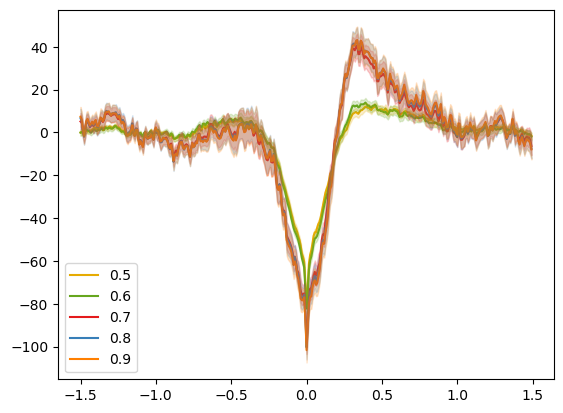

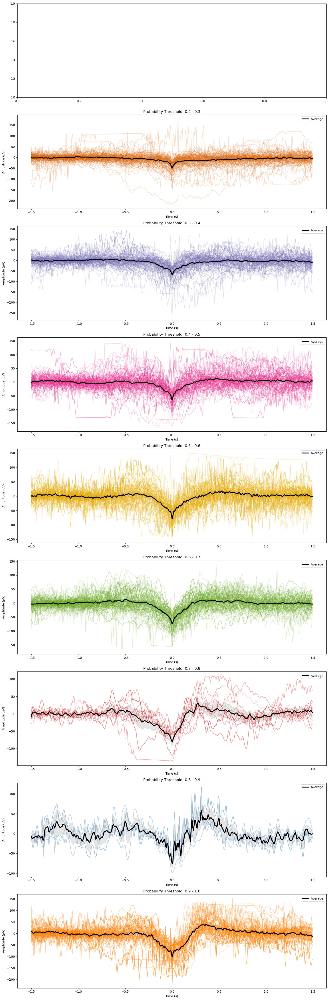

Extracting EDF parameters from /home/ec2-user/SageMaker/datasets/nsrr/shhs/polysomnography/edfs/shhs1/shhs1-200002.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 4046249  =      0.000 ... 32369.992 secs...
Filtering raw data in 1 contiguous segment
Setting up high-pass filter at 0.3 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal highpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.30
- Lower transition bandwidth: 0.30 Hz (-6 dB cutoff frequency: 0.15 Hz)
- Filter length: 1409 samples (11.008 s)

533 K-complexes were detected


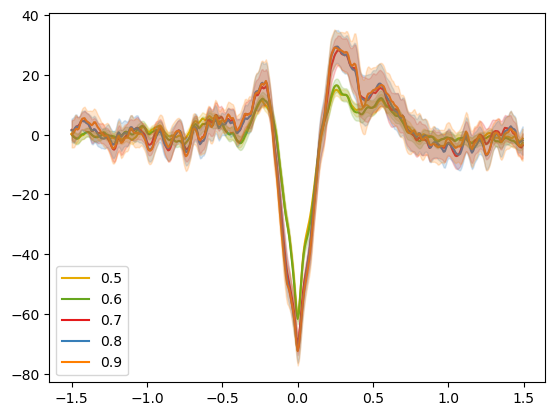

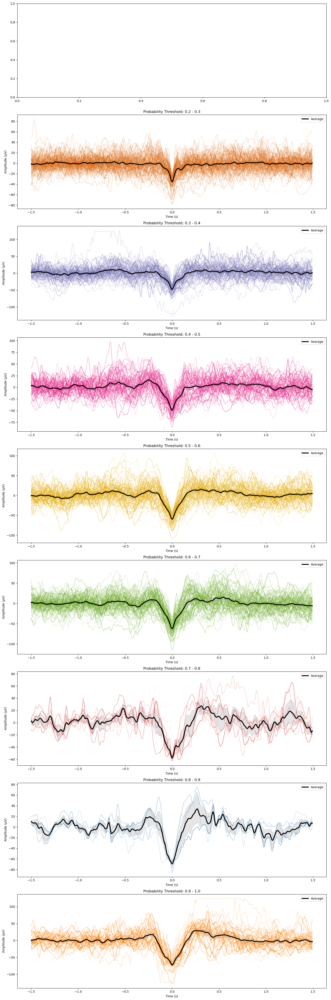

Extracting EDF parameters from /home/ec2-user/SageMaker/datasets/nsrr/shhs/polysomnography/edfs/shhs1/shhs1-200003.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 3933749  =      0.000 ... 31469.992 secs...
Filtering raw data in 1 contiguous segment
Setting up high-pass filter at 0.3 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal highpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.30
- Lower transition bandwidth: 0.30 Hz (-6 dB cutoff frequency: 0.15 Hz)
- Filter length: 1409 samples (11.008 s)



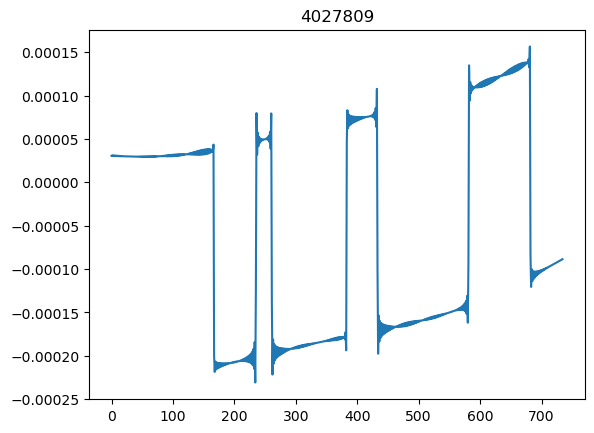

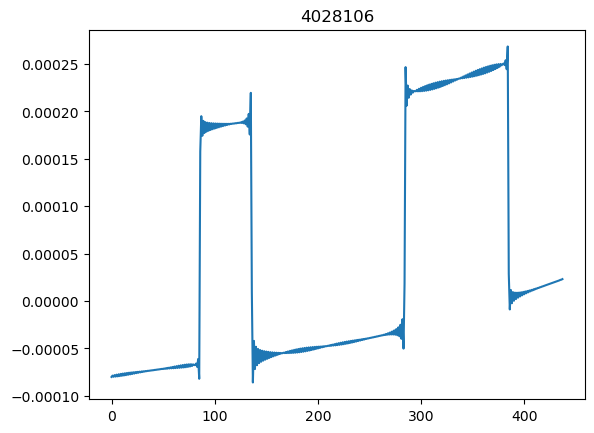

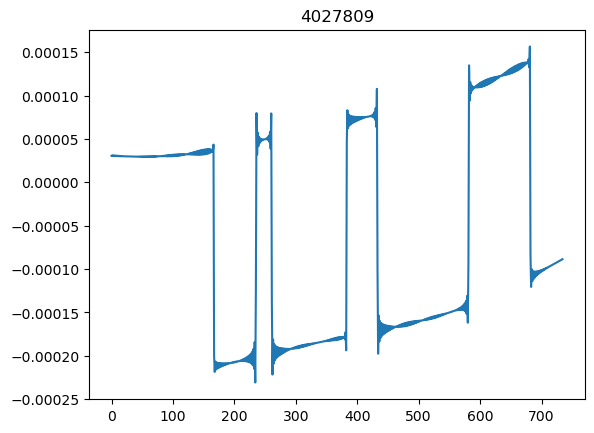

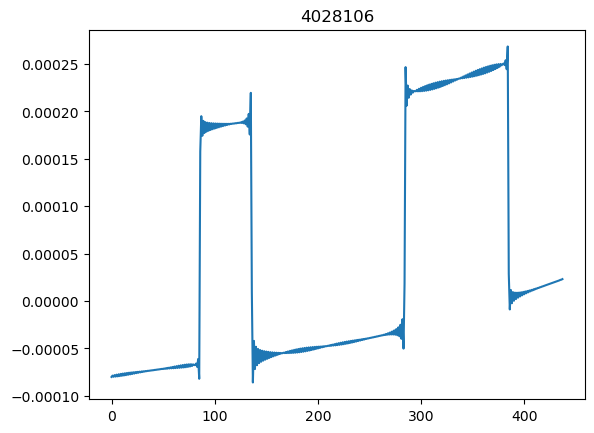

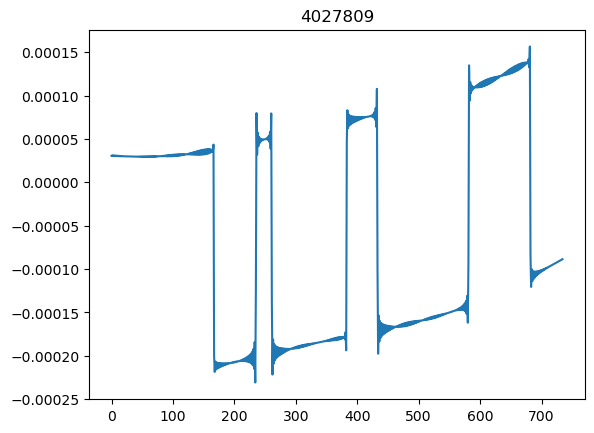

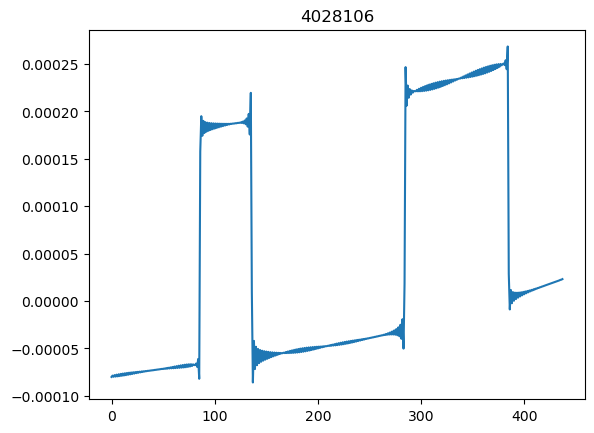

6035 K-complexes were detected


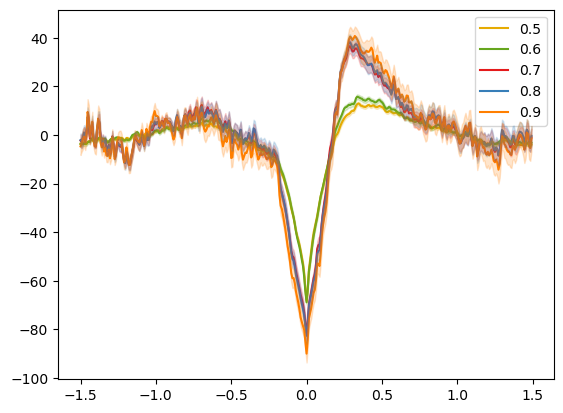

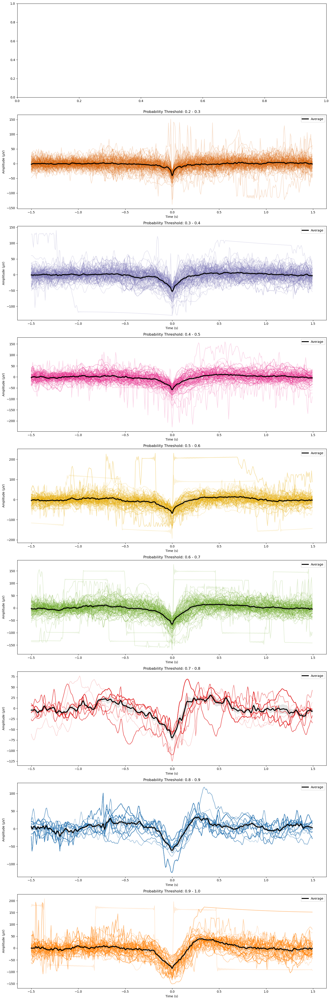

Extracting EDF parameters from /home/ec2-user/SageMaker/datasets/nsrr/shhs/polysomnography/edfs/shhs1/shhs1-200004.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 3281249  =      0.000 ... 26249.992 secs...
Filtering raw data in 1 contiguous segment
Setting up high-pass filter at 0.3 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal highpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.30
- Lower transition bandwidth: 0.30 Hz (-6 dB cutoff frequency: 0.15 Hz)
- Filter length: 1409 samples (11.008 s)

5414 K-complexes were detected


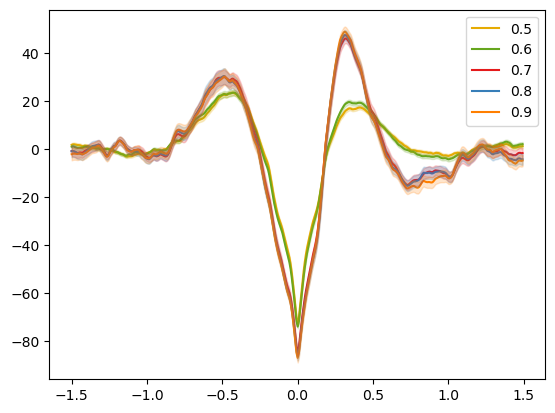

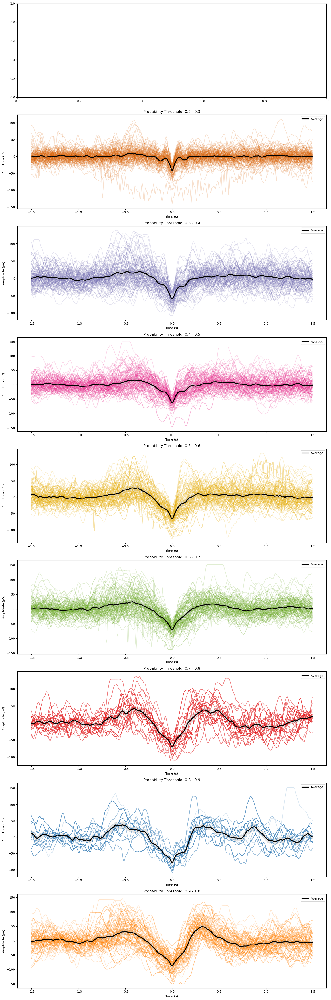

Extracting EDF parameters from /home/ec2-user/SageMaker/datasets/nsrr/shhs/polysomnography/edfs/shhs1/shhs1-200005.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 4064999  =      0.000 ... 32519.992 secs...
Filtering raw data in 1 contiguous segment
Setting up high-pass filter at 0.3 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal highpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.30
- Lower transition bandwidth: 0.30 Hz (-6 dB cutoff frequency: 0.15 Hz)
- Filter length: 1409 samples (11.008 s)

601 K-complexes were detected


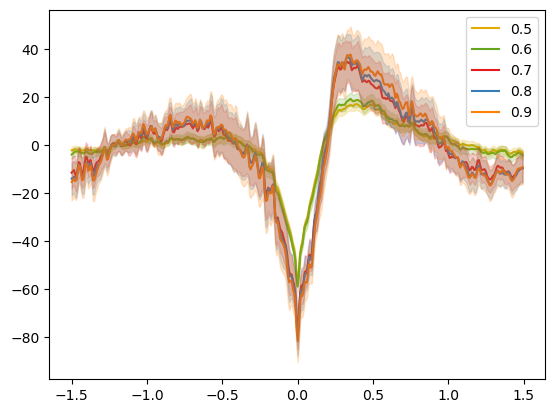

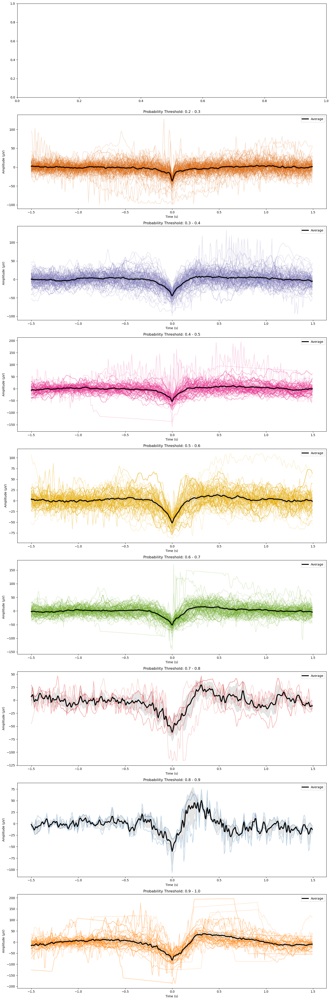

Extracting EDF parameters from /home/ec2-user/SageMaker/datasets/nsrr/shhs/polysomnography/edfs/shhs1/shhs1-200006.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 4064999  =      0.000 ... 32519.992 secs...
Filtering raw data in 1 contiguous segment
Setting up high-pass filter at 0.3 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal highpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.30
- Lower transition bandwidth: 0.30 Hz (-6 dB cutoff frequency: 0.15 Hz)
- Filter length: 1409 samples (11.008 s)

4249 K-complexes were detected


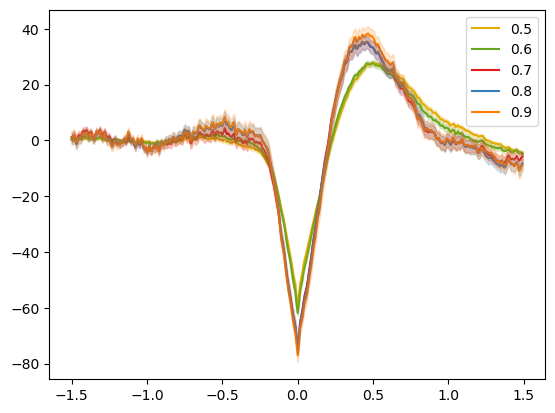

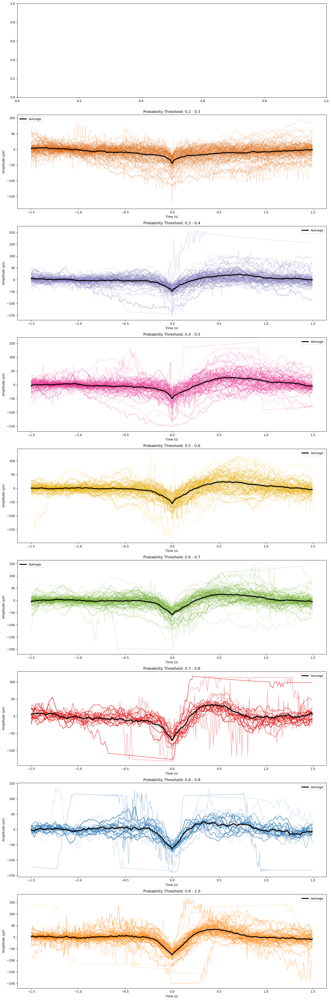

Extracting EDF parameters from /home/ec2-user/SageMaker/datasets/nsrr/shhs/polysomnography/edfs/shhs1/shhs1-200007.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 3446249  =      0.000 ... 27569.992 secs...
Filtering raw data in 1 contiguous segment
Setting up high-pass filter at 0.3 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal highpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.30
- Lower transition bandwidth: 0.30 Hz (-6 dB cutoff frequency: 0.15 Hz)
- Filter length: 1409 samples (11.008 s)



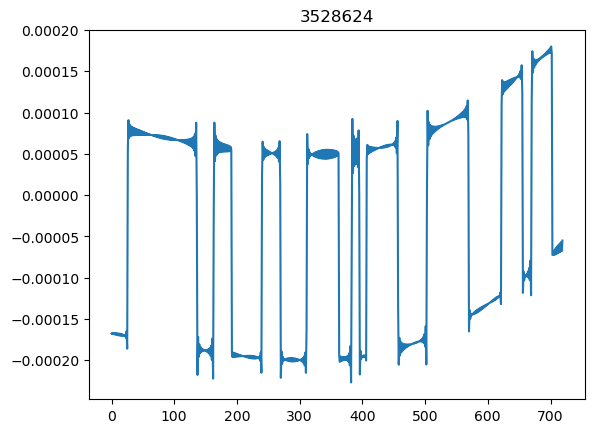

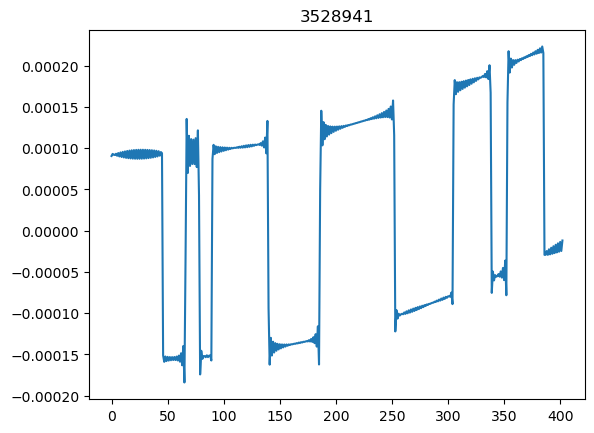

2199 K-complexes were detected


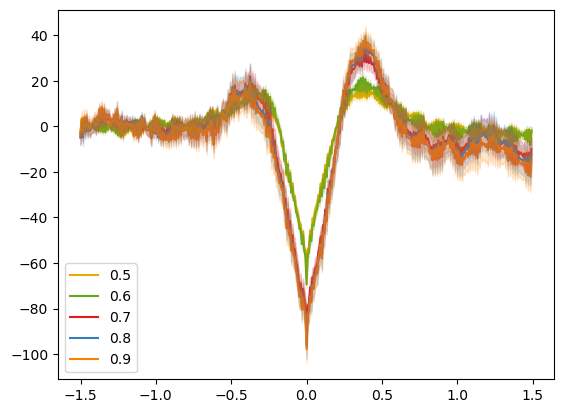

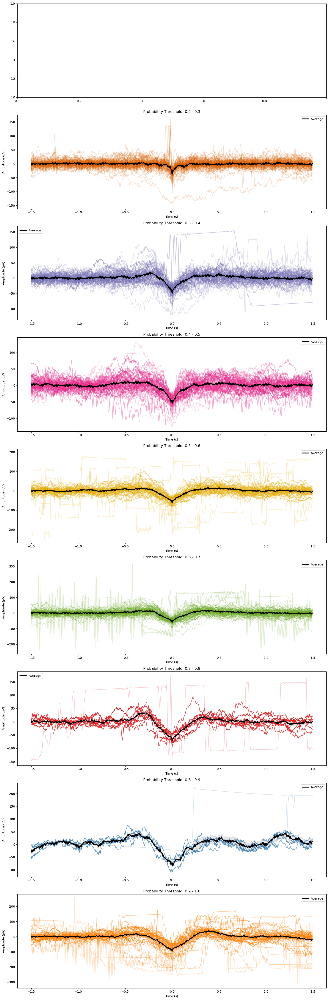

Extracting EDF parameters from /home/ec2-user/SageMaker/datasets/nsrr/shhs/polysomnography/edfs/shhs1/shhs1-200008.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 3596249  =      0.000 ... 28769.992 secs...
Filtering raw data in 1 contiguous segment
Setting up high-pass filter at 0.3 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal highpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.30
- Lower transition bandwidth: 0.30 Hz (-6 dB cutoff frequency: 0.15 Hz)
- Filter length: 1409 samples (11.008 s)

502 K-complexes were detected


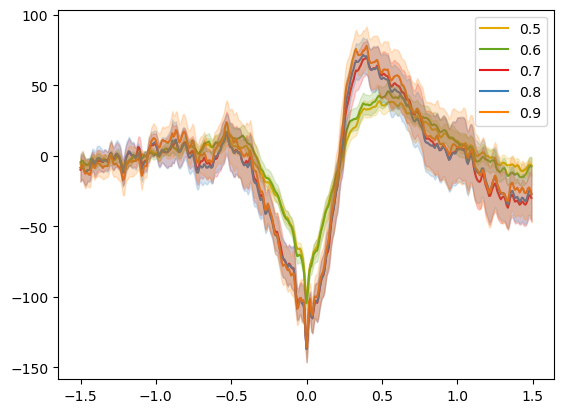

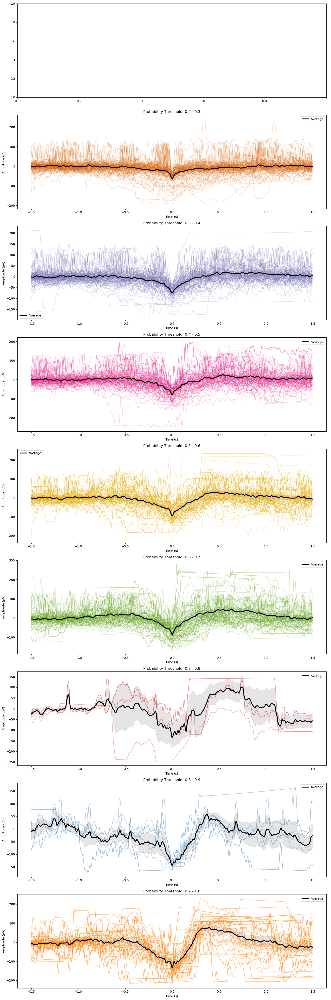

Extracting EDF parameters from /home/ec2-user/SageMaker/datasets/nsrr/shhs/polysomnography/edfs/shhs1/shhs1-200009.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 4072499  =      0.000 ... 32579.992 secs...
Filtering raw data in 1 contiguous segment
Setting up high-pass filter at 0.3 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal highpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.30
- Lower transition bandwidth: 0.30 Hz (-6 dB cutoff frequency: 0.15 Hz)
- Filter length: 1409 samples (11.008 s)



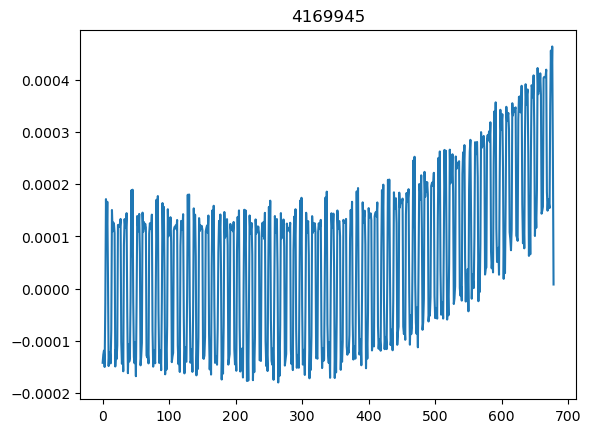

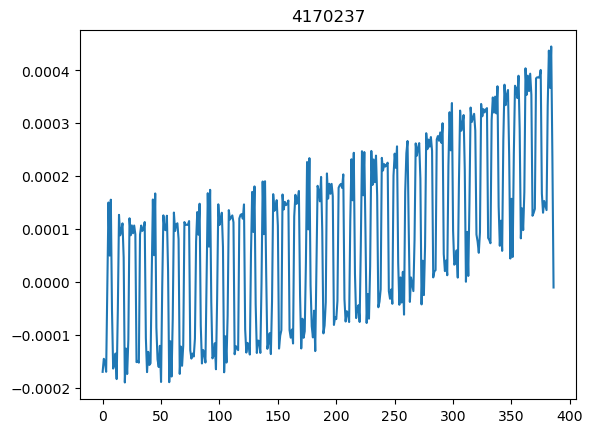

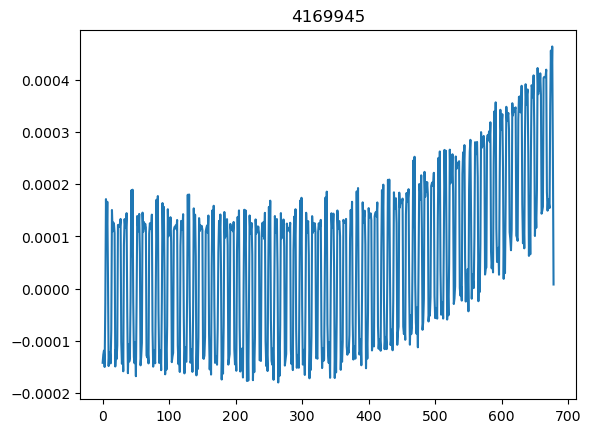

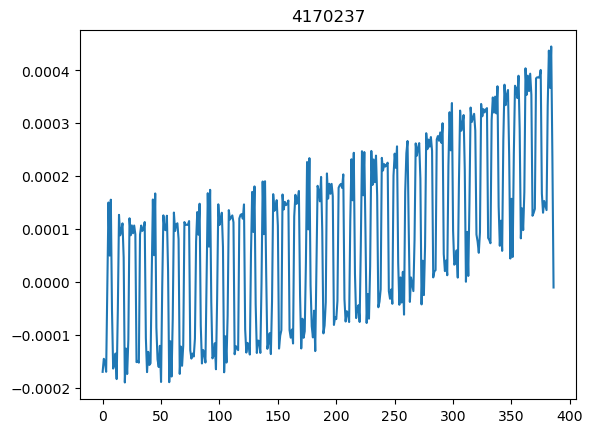

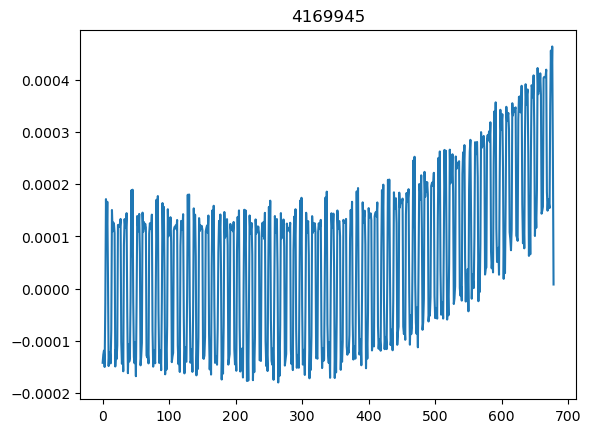

...

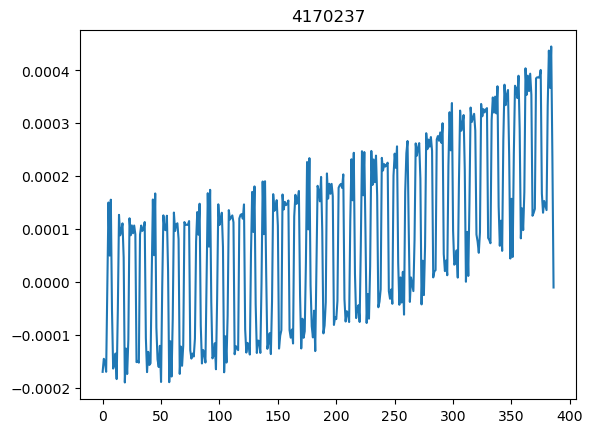

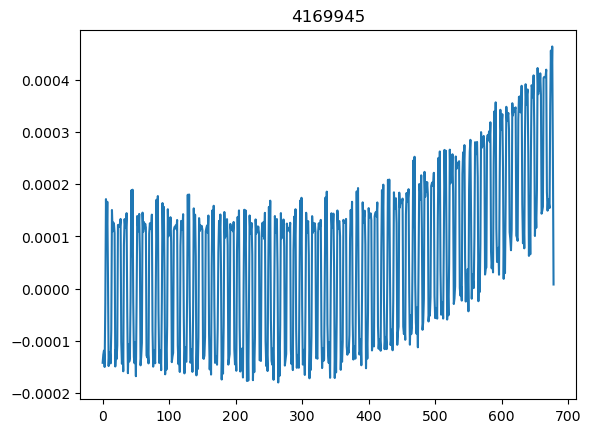

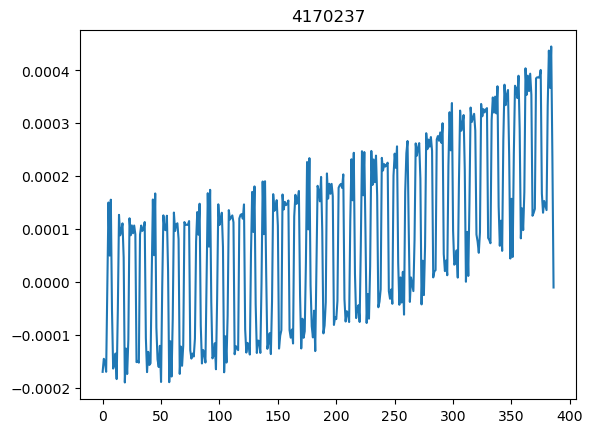

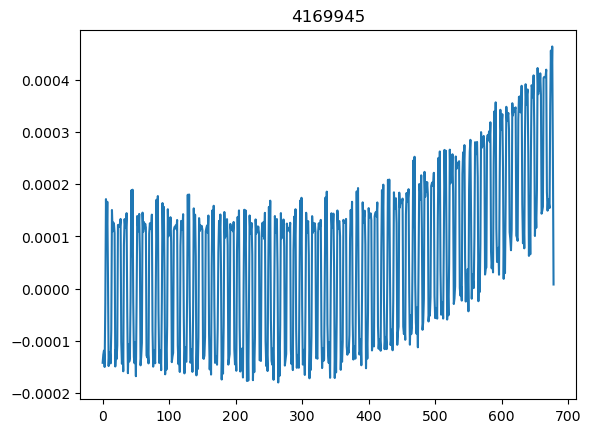

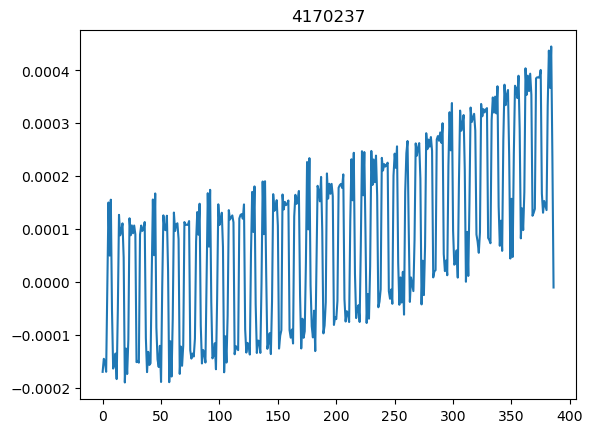

17457 K-complexes were detected


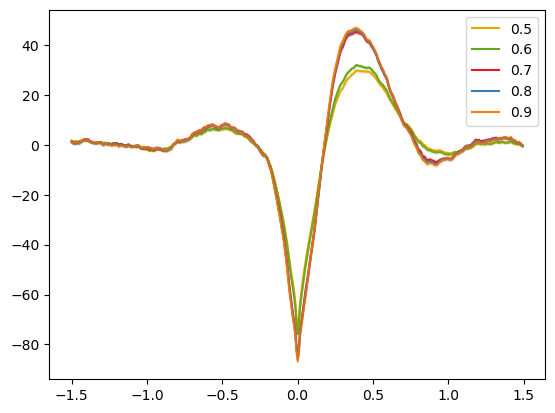

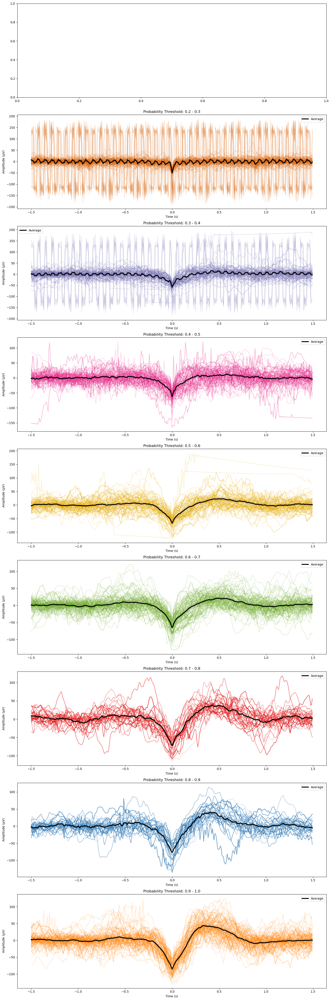

Extracting EDF parameters from /home/ec2-user/SageMaker/datasets/nsrr/shhs/polysomnography/edfs/shhs1/shhs1-200010.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 4064999  =      0.000 ... 32519.992 secs...
Filtering raw data in 1 contiguous segment
Setting up high-pass filter at 0.3 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal highpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.30
- Lower transition bandwidth: 0.30 Hz (-6 dB cutoff frequency: 0.15 Hz)
- Filter length: 1409 samples (11.008 s)



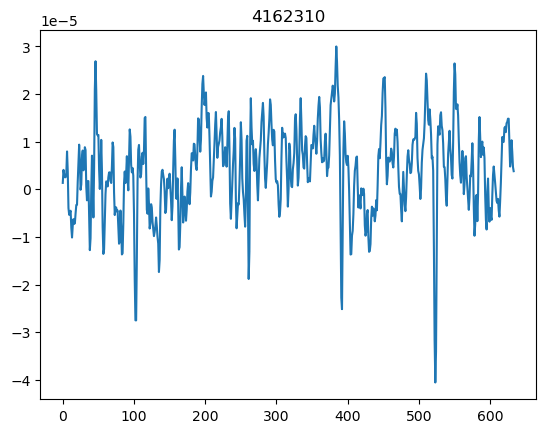

2943 K-complexes were detected


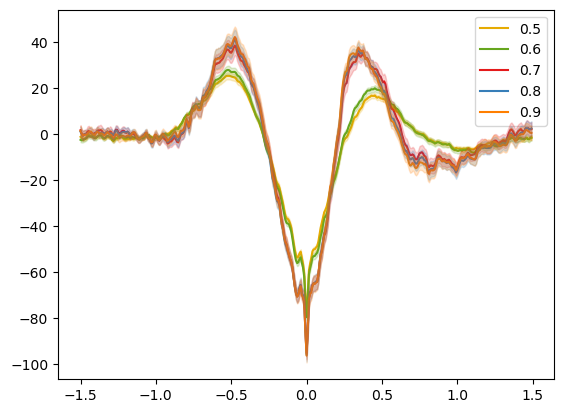

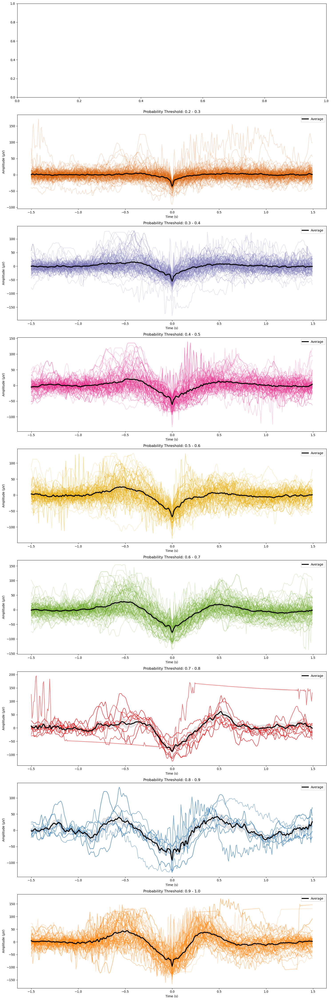

In [35]:
avg_predictions = []

for edf, annot in file_paths[:10]:
    avg_KC = run(edf,annot)
    avg_predictions.append(avg_KC)

In [ ]:
colors = ['#1b9e77', '#d95f02', '#7570b3', '#e7298a', '#e6ab02', '#66a61e', '#e41a1c', '#377eb8', '#ff7f00']

for idx, (av, upper_bound, lower_bound) in enumerate(avg_predictions[:len(colors)]):
    times = np.arange(0, 3, 3 / len(av)) - 1.5

    plt.plot(times, av, color=colors[idx], label=str(idx))
    plt.fill_between(times, upper_bound, lower_bound,
                     zorder=9, color=colors[idx], alpha=.2,
                     clip_on=False)
plt.legend()
plt.show()

In [ ]:
######### Pre-processing ###########
edf_filename = file_paths[0][0]
annot_filename = file_paths[0][1]

raw = mne.io.read_raw_edf(edf_filename, preload=True)
raw, _ = mne.set_eeg_reference(raw, [], verbose='warning') # data is already referenced in this NSRR file
raw.resample(128)
raw = raw.filter(0.3, None)

In [ ]:
## Import hypnogram ##
events, hypno = import_event_and_stages_SHHS(xml_file=annot_filename)

In [ ]:
## Parameters for K-complex scoring ##
wanted_channel = 'EEG'
wanted_sleep_stages = [2] #, 3]
# We multiply the channel by -1 since the algorithm was trained on negative EEG polarity
C3 = np.asarray(
    [raw[count, :][0] for count, k in enumerate(raw.info['ch_names']) if k == wanted_channel]).ravel() * -1
Fs = raw.info['sfreq']

# C3 is the full timeseries
# Time of peaks
# Sleep stage of peaks
# An instance of EpochData, representing data epochs centered around detected peaks in the EEG signal
# Probabillity of peaks
peaks, stage_peaks, d, probas = score_KCs(C3, Fs, hypno, sleep_stages=wanted_sleep_stages)

In [ ]:
#######################################################################
probability_threshold = 0.5 # Include only waveforms scored with a probability of at least 50%

labels_selected = np.where(probas > probability_threshold, 1, 0)
onsets_selected = peaks[probas > probability_threshold]
probas_selected = probas[probas > probability_threshold]

In [ ]:
print('{} K-complexes were detected'.format(np.sum(labels_selected)))

avg_KC = get_avg_KC(C3 * -1, peaks, probas, Fs, threshold = 0.8)

########################################################################
####                        VISUALISATION                           ####

##----- Average K-complexes for different probability thresholds ------##
KC_from_probas(C3 * -1, onsets_selected, probas_selected, Fs)
plot_all_Kcs(C3 * -1, peaks, probas, Fs)